This notebook demonstrates our graph network inductive bias with a symbolic model extraction.

# Preamble and data generation

## Make sure to turn on the GPU via Edit-> Notebook settings. 

In [1]:
#Basic pre-reqs:
import numpy as np
import os
import torch
from torch.autograd import Variable
from matplotlib import pyplot as plt
%matplotlib inline

## Download pre-reqs, and then code for simulations and model files:

(Note: installing torch-geometric may take a long time.)

In [2]:
!pip install celluloid

In [3]:
version_nums = torch.__version__.split('.')
# Torch Geometric seems to always build for *.*.0 of torch :
version_nums[-1] = '0' + version_nums[-1][1:]
os.environ['TORCH'] = '.'.join(version_nums)
 
!pip install --upgrade torch-scatter -f https://pytorch-geometric.com/whl/torch-${TORCH}.html && pip install --upgrade torch-sparse -f https://pytorch-geometric.com/whl/torch-${TORCH}.html && pip install --upgrade torch-geometric

Looking in links: https://pytorch-geometric.com/whl/torch-1.12.0.html
Looking in links: https://pytorch-geometric.com/whl/torch-1.12.0.html


In [4]:
!wget https://raw.githubusercontent.com/MilesCranmer/symbolic_deep_learning/master/models.py -O models.py
!wget https://raw.githubusercontent.com/MilesCranmer/symbolic_deep_learning/master/simulate.py -O simulate.py

--2023-02-18 17:06:20--  https://raw.githubusercontent.com/MilesCranmer/symbolic_deep_learning/master/models.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.111.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 9647 (9.4K) [text/plain]
Saving to: ‘models.py’

models.py           100%[===================>]   9.42K  --.-KB/s    in 0s      

2023-02-18 17:06:20 (27.1 MB/s) - ‘models.py’ saved [9647/9647]

--2023-02-18 17:06:21--  https://raw.githubusercontent.com/MilesCranmer/symbolic_deep_learning/master/simulate.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.111.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 9752 (9.5K) [text/p

In [5]:
import models
import simulate

## Assert we have a GPU:

In [ ]:
# torch.ones(1).cuda()

## Create the simulation:

In [6]:
# Number of simulations to run (it's fast, don't worry):
ns = 10000
# Potential (see below for options)
sim = 'spring'
# Number of nodes
n = 4
# Dimension
dim = 2
# Number of time steps
nt = 1000


#Standard simulation sets:
n_set = [4, 8]
sim_sets = [
 {'sim': 'r1', 'dt': [5e-3], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'r2', 'dt': [1e-3], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'spring', 'dt': [1e-2], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'string', 'dt': [1e-2], 'nt': [1000], 'n': [30], 'dim': [2]},
 {'sim': 'charge', 'dt': [1e-3], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'superposition', 'dt': [1e-3], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'damped', 'dt': [2e-2], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'discontinuous', 'dt': [1e-2], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
]


#Select the hand-tuned dt value for a smooth simulation
# (since scales are different in each potential):
dt = [ss['dt'][0] for ss in sim_sets if ss['sim'] == sim][0]

title = '{}_n={}_dim={}_nt={}_dt={}'.format(sim, n, dim, nt, dt)
print('Running on', title)

Running on spring_n=4_dim=2_nt=1000_dt=0.01


## Generate simulation data:

In [7]:
from simulate import SimulationDataset
s = SimulationDataset(sim, n=n, dim=dim, nt=nt//2, dt=dt)
# Update this to your own dataset, or regenerate:
base_str = './'
data_str = title
s.simulate(ns)

In [8]:
data = s.data
s.data.shape

(10000, 500, 4, 6)

In [9]:
data[0,0,0,5]

Array(0.7886358, dtype=float32)

### Let's visualize an example simulation:

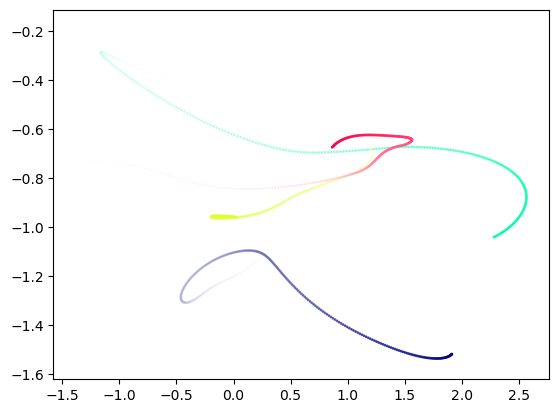

In [10]:
s.plot(9999, animate=True, plot_size=False)

## We'll train on the accelerations, so let's generate the dataset:

In [11]:
accel_data = s.get_acceleration()

In [12]:
X = torch.from_numpy(np.concatenate([s.data[:, i] for i in range(0, s.data.shape[1], 5)]))
y = torch.from_numpy(np.concatenate([accel_data[:, i] for i in range(0, s.data.shape[1], 5)]))

In [13]:
from sklearn.model_selection import train_test_split

In [14]:
X_train, X_test, y_train, y_test = train_test_split(X, y, shuffle=False)

In [15]:
data_test = s.data[0]
accel_test = accel_data[0]
print(data_test.shape)
print(accel_test.shape)

(500, 4, 6)
(500, 4, 2)


In [16]:
print(data_test[0])

[[ 2.0274465   0.12346178 -1.810647    0.26113966 -0.43152463  0.7886358 ]
 [ 1.2941198  -0.5355589  -0.353034    1.442077   -0.40950936  1.195086  ]
 [-2.172818    0.39194798 -1.5027773   0.87220526  0.49295962  4.5856786 ]
 [ 0.16172081 -1.0134072   1.2195634  -0.68870366  1.0173919   1.0502859 ]]


In [17]:
print(accel_test[0])

[[-10.726303    -1.0490881 ]
 [ -4.5751915    0.9639173 ]
 [  3.1442306   -0.7727325 ]
 [ -0.46800357   3.0647724 ]]


In [18]:
accel_data[0].shape

(500, 4, 2)

# Set up the model

In [19]:
import torch
from torch import nn
from torch.functional import F
from torch.optim import Adam
from torch_geometric.nn import MetaLayer, MessagePassing

In [20]:
from models import OGN, varOGN, make_packer, make_unpacker, get_edge_index

## Use the L1 regularization model:

In [21]:
aggr = 'add'
hidden = 300

test = '_l1_'

#This test applies an explicit bottleneck:

msg_dim = 100
n_f = data.shape[3]

In [22]:
print(n_f)

6


L1 loss: we simply add the loss to the batch number. I.e., * 32 for batch size 32.

KL loss: model the messages as a distribution with the prior a Gaussian. The means add in the final Gaussian. 
Recall in the D_KL(p||q), the prior is q.  Then, for sigma_q = 1, mu_q = 0, we have ($p=1$):

$$D_{KL}(p||q) = \frac{\sigma_p^2 + \mu_p^2}{2} -\log({\sigma_p}) - \frac{1}{2}$$

## We use a custom data loader for the graphs for fast training:

In [23]:
from torch_geometric.data import Data, DataLoader

In [24]:
from models import get_edge_index

In [25]:
edge_index = get_edge_index(n, sim)

In [26]:
print(edge_index)

tensor([[0, 0, 0, 1, 1, 1, 2, 2, 2, 3, 3, 3],
        [1, 2, 3, 0, 2, 3, 0, 1, 3, 0, 1, 2]])


## Initiate the model:

In [ ]:
# if test == '_kl_':
#     ogn = varOGN(n_f, msg_dim, dim, dt=0.1, hidden=hidden, edge_index=get_edge_index(n, sim), aggr=aggr).cuda()
# else:
#     ogn = OGN(n_f, msg_dim, dim, dt=0.1, hidden=hidden, edge_index=get_edge_index(n, sim), aggr=aggr).cuda()

# messages_over_time = []
# ogn = ogn.cuda()

In [27]:
# no cuda
if test == '_kl_':
    ogn = varOGN(n_f, msg_dim, dim, dt=0.1, hidden=hidden, edge_index=get_edge_index(n, sim), aggr=aggr)
else:
    ogn = OGN(n_f, msg_dim, dim, dt=0.1, hidden=hidden, edge_index=get_edge_index(n, sim), aggr=aggr)

messages_over_time = []
ogn = ogn

### Let's test it:

In [ ]:
# _q = Data(
#     x=X_train[0].cuda(),
#     edge_index=edge_index.cuda(),
#     y=y_train[0].cuda())
# ogn(_q.x, _q.edge_index), ogn.just_derivative(_q).shape, _q.y.shape, ogn.loss(_q), 

In [28]:
# no cuda
_q = Data(
    x=X_train[0],
    edge_index=edge_index,
    y=y_train[0])
ogn(_q.x, _q.edge_index), ogn.just_derivative(_q).shape, _q.y.shape, ogn.loss(_q), 

(tensor([[-0.0021, -0.0387],
         [-0.0127, -0.0448],
         [-0.0013, -0.0158],
         [-0.0200, -0.0516]], grad_fn=<AddmmBackward0>),
 torch.Size([4, 2]),
 torch.Size([4, 2]),
 tensor(24.7954, grad_fn=<SumBackward0>))

In [29]:
_q.y

tensor([[-10.7263,  -1.0491],
        [ -4.5752,   0.9639],
        [  3.1442,  -0.7727],
        [ -0.4680,   3.0648]])

In [30]:
ogn.just_derivative(_q)

tensor([[-0.0021, -0.0387],
        [-0.0127, -0.0448],
        [-0.0013, -0.0158],
        [-0.0200, -0.0516]], grad_fn=<AddmmBackward0>)

In [31]:
torch.abs(_q.y - ogn.just_derivative(_q))

tensor([[10.7242,  1.0104],
        [ 4.5625,  1.0087],
        [ 3.1456,  0.7569],
        [ 0.4480,  3.1164]], grad_fn=<AbsBackward0>)

In [32]:
torch.sum(torch.abs(_q.y - ogn.just_derivative(_q)))

tensor(24.7726, grad_fn=<SumBackward0>)

# Set up training

## Organize into data loader:

In [33]:
batch = int(64 * (4 / n)**2)
trainloader = DataLoader(
    [Data(
        Variable(X_train[i]),
        edge_index=edge_index,
        y=Variable(y_train[i])) for i in range(len(y_train))],
    batch_size=batch,
    shuffle=True
)

testloader = DataLoader(
    [Data(
        X_test[i],
        edge_index=edge_index,
        y=y_test[i]) for i in range(len(y_test))],
    batch_size=1024,
    shuffle=True
)

/Users/james/.pyenv/versions/3.10.7/lib/python3.10/site-packages/torch_geometric/deprecation.py:12: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


In [34]:
batch

64

## We'll use OneCycleLR for fast training:

In [35]:
from torch.optim.lr_scheduler import ReduceLROnPlateau, OneCycleLR

## Create the loss function

This holds definition of our L1 and KL regularizations:

In [36]:
def new_loss(self, g, augment=True, square=False):
    if square:
        return torch.sum((g.y - self.just_derivative(g, augment=augment))**2)
    else:
        base_loss = torch.sum(torch.abs(g.y - self.just_derivative(g, augment=augment)))
        if test in ['_l1_', '_kl_']:
            s1 = g.x[self.edge_index[0]]
            s2 = g.x[self.edge_index[1]]
            if test == '_l1_':
                m12 = self.message(s1, s2)
                regularization = 1e-2
                #Want one loss value per row of g.y:
                normalized_l05 = torch.sum(torch.abs(m12))
                # NOTE: regularization term is multiplied by batch size here,
                # but we divide by batch size later so it cancels
                return base_loss, regularization * batch * normalized_l05 / n**2 * n
            elif test == '_kl_':
                regularization = 1
                #Want one loss value per row of g.y:
                tmp = torch.cat([s1, s2], dim=1)  # tmp has shape [E, 2 * in_channels]
                raw_msg = self.msg_fnc(tmp)
                mu = raw_msg[:, 0::2]
                logvar = raw_msg[:, 1::2]
                full_kl = torch.sum(torch.exp(logvar) + mu**2 - logvar)/2.0
                return base_loss, regularization * batch * full_kl / n**2 * n
        return base_loss

In [37]:
new_loss(ogn, _q)

(tensor(24.7660, grad_fn=<SumBackward0>),
 tensor(9.7376, grad_fn=<MulBackward0>))

In [38]:
base_loss = torch.sum(torch.abs(_q.y - ogn.just_derivative(_q, augment=True)))
print(base_loss)
s1 = _q.x[ogn.edge_index[0]]
s2 = _q.x[ogn.edge_index[1]]
print(s1.shape)
# print(ogn.edge_index[0])
# print(s1)
# print(torch.cat([s1, s2], dim=1))
m12 = ogn.message(s1, s2)
# print(m12)
regularization = 1e-2
normalized_105 = torch.sum(torch.abs(m12))
print(normalized_105)

tensor(24.7845, grad_fn=<SumBackward0>)
torch.Size([12, 6])
tensor(60.8599, grad_fn=<SumBackward0>)


## Set up optimizer and training parameters:

**Use 200 epochs for full version; can use fewer for test.**

In [45]:
init_lr = 1e-3

opt = torch.optim.Adam(ogn.parameters(), lr=init_lr, weight_decay=1e-8)

total_epochs = 200
# total_epochs = 100
# total_epochs = 30


batch_per_epoch = int(1000*10 / (batch/32.0))

sched = OneCycleLR(opt, max_lr=init_lr,
                   steps_per_epoch=batch_per_epoch,#len(trainloader),
                   epochs=total_epochs, final_div_factor=1e5)

batch_per_epoch

5000

In [40]:
epoch = 0

In [41]:
from tqdm import tqdm

## Organize the recording of messages over time

This is for fitting the forces, and extracting laws:

In [42]:
import numpy as onp
onp.random.seed(0)
test_idxes = onp.random.randint(0, len(X_test), 1000)

#Record messages over test dataset here:
newtestloader = DataLoader(
    [Data(
        X_test[i],
        edge_index=edge_index,
        y=y_test[i]) for i in test_idxes],
    batch_size=len(X_test),
    shuffle=False
)

### Function to record messages from model

In [43]:
import numpy as onp
import pandas as pd

def get_messages(ogn):

    def get_message_info(tmp):
        ogn.cpu()

        s1 = tmp.x[tmp.edge_index[0]]
        s2 = tmp.x[tmp.edge_index[1]]
        tmp = torch.cat([s1, s2], dim=1)  # tmp has shape [E, 2 * in_channels]
        if test == '_kl_':
            raw_msg = ogn.msg_fnc(tmp)
            mu = raw_msg[:, 0::2]
            logvar = raw_msg[:, 1::2]

            m12 = mu
        else:
            m12 = ogn.msg_fnc(tmp)

        all_messages = torch.cat((
            s1,
            s2,
            m12), dim=1)
        if dim == 2:
            columns = [elem%(k) for k in range(1, 3) for elem in 'x%d y%d vx%d vy%d q%d m%d'.split(' ')]
            columns += ['e%d'%(k,) for k in range(msg_dim)]
        elif dim == 3:
            columns = [elem%(k) for k in range(1, 3) for elem in 'x%d y%d z%d vx%d vy%d vz%d q%d m%d'.split(' ')]
            columns += ['e%d'%(k,) for k in range(msg_dim)]


        return pd.DataFrame(
            data=all_messages.cpu().detach().numpy(),
            columns=columns
        )

    msg_info = []
    for i, g in enumerate(newtestloader):
        msg_info.append(get_message_info(g))

    msg_info = pd.concat(msg_info)
    msg_info['dx'] = msg_info.x1 - msg_info.x2
    msg_info['dy'] = msg_info.y1 - msg_info.y2
    if dim == 2:
        msg_info['r'] = np.sqrt(
            (msg_info.dx)**2 + (msg_info.dy)**2
        )
    elif dim == 3:
        msg_info['dz'] = msg_info.z1 - msg_info.z2
        msg_info['r'] = np.sqrt(
            (msg_info.dx)**2 + (msg_info.dy)**2 + (msg_info.dz)**2
        )
    
    return msg_info

In [44]:
recorded_models = []

# Train the model:

## Training loop:

In [48]:
# for epoch in tqdm(range(epoch, total_epochs)):
#     ogn.cuda()
#     total_loss = 0.0
#     i = 0
#     num_items = 0
#     while i < batch_per_epoch:
#         for ginput in trainloader:
#             if i >= batch_per_epoch:
#                 break
#             opt.zero_grad()
#             ginput.x = ginput.x.cuda()
#             ginput.y = ginput.y.cuda()
#             ginput.edge_index = ginput.edge_index.cuda()
#             ginput.batch = ginput.batch.cuda()
#             if test in ['_l1_', '_kl_']:
#                 loss, reg = new_loss(ogn, ginput, square=False)
#                 ((loss + reg)/int(ginput.batch[-1]+1)).backward()
#             else:
#                 loss = ogn.loss(ginput, square=False)
#                 (loss/int(ginput.batch[-1]+1)).backward()
#             opt.step()
#             sched.step()

#             total_loss += loss.item()
#             i += 1
#             num_items += int(ginput.batch[-1]+1)

#     cur_loss = total_loss/num_items
#     print(cur_loss)
#     cur_msgs = get_messages(ogn)
#     cur_msgs['epoch'] = epoch
#     cur_msgs['loss'] = cur_loss
#     messages_over_time.append(cur_msgs)
    
#     ogn.cpu()
#     from copy import deepcopy as copy
#     recorded_models.append(ogn.state_dict())

In [46]:
# no cuda
# don't record all messages and models (takes up >1GB memory to record all epochs)
for epoch in tqdm(range(epoch, total_epochs)):
    total_loss = 0.0
    i = 0
    num_items = 0
    while i < batch_per_epoch:
        for ginput in trainloader:
            if i >= batch_per_epoch:
                break
            opt.zero_grad()
            if test in ['_l1_', '_kl_']:
                loss, reg = new_loss(ogn, ginput, square=False)
                ((loss + reg)/int(ginput.batch[-1]+1)).backward()
                # ginput.batch[-1]+1 = size of batch
            else:
                loss = ogn.loss(ginput, square=False)
                (loss/int(ginput.batch[-1]+1)).backward()
            opt.step()
            sched.step()

            total_loss += loss.item()
            i += 1
            num_items += int(ginput.batch[-1]+1)

    cur_loss = total_loss/num_items
    print(cur_loss)
#     cur_msgs = get_messages(ogn)
#     cur_msgs['epoch'] = epoch
#     cur_msgs['loss'] = cur_loss
#     messages_over_time.append(cur_msgs)
    
#     ogn.cpu()
#     from copy import deepcopy as copy
#     recorded_models.append(ogn.state_dict())

  0%|▏                                        | 1/200 [00:37<2:03:59, 37.38s/it]

12.293204387760163


  1%|▍                                        | 2/200 [01:15<2:04:33, 37.75s/it]

8.324757454299927


  2%|▌                                        | 3/200 [01:52<2:02:20, 37.26s/it]

6.396183704900742


  2%|▊                                        | 4/200 [02:30<2:02:41, 37.56s/it]

5.098748289299011


  2%|█                                        | 5/200 [03:09<2:04:15, 38.23s/it]

4.4602577179431915


  3%|█▏                                       | 6/200 [03:49<2:05:04, 38.68s/it]

4.0781610935211186


  4%|█▍                                       | 7/200 [04:28<2:05:27, 39.00s/it]

3.894553854775429


  4%|█▋                                       | 8/200 [05:07<2:04:55, 39.04s/it]

3.6835876522779465


  4%|█▊                                       | 9/200 [05:46<2:04:08, 38.99s/it]

3.483296253347397


  5%|██                                      | 10/200 [06:25<2:02:48, 38.78s/it]

3.4044542639255524


  6%|██▏                                     | 11/200 [07:03<2:01:35, 38.60s/it]

3.2789623406410215


  6%|██▍                                     | 12/200 [07:41<2:00:52, 38.58s/it]

3.17607950797081


  6%|██▌                                     | 13/200 [08:21<2:01:10, 38.88s/it]

3.0088524023532868


  7%|██▊                                     | 14/200 [08:59<2:00:18, 38.81s/it]

2.855582936501503


  8%|███                                     | 15/200 [09:39<2:00:11, 38.98s/it]

2.7086084862947466


  8%|███▏                                    | 16/200 [10:18<1:59:25, 38.95s/it]

2.4921716680765154


  8%|███▍                                    | 17/200 [10:59<2:00:36, 39.54s/it]

2.3093044103741645


  9%|███▌                                    | 18/200 [11:38<1:59:57, 39.55s/it]

2.0893827484488487


 10%|███▊                                    | 19/200 [12:19<2:00:04, 39.81s/it]

1.941053297007084


 10%|████                                    | 20/200 [13:01<2:01:58, 40.66s/it]

1.8662183022499084


 10%|████▏                                   | 21/200 [13:42<2:01:13, 40.63s/it]

1.7363119332194328


 11%|████▍                                   | 22/200 [14:23<2:01:16, 40.88s/it]

1.6126097793340683


 12%|████▌                                   | 23/200 [15:02<1:58:59, 40.34s/it]

1.5265647346138955


 12%|████▊                                   | 24/200 [15:41<1:56:58, 39.88s/it]

1.5040854862332345


 12%|█████                                   | 25/200 [16:21<1:56:10, 39.83s/it]

1.4456735587835312


 13%|█████▏                                  | 26/200 [17:00<1:54:50, 39.60s/it]

1.4043827395439148


 14%|█████▍                                  | 27/200 [17:39<1:54:07, 39.58s/it]

1.3735728715896607


 14%|█████▌                                  | 28/200 [18:22<1:56:04, 40.49s/it]

1.3884332082390785


 14%|█████▊                                  | 29/200 [19:02<1:54:51, 40.30s/it]

1.373964231491089


 15%|██████                                  | 30/200 [19:41<1:52:58, 39.87s/it]

1.3367457590579988


 16%|██████▏                                 | 31/200 [20:21<1:52:26, 39.92s/it]

1.368751751756668


 16%|██████▍                                 | 32/200 [21:02<1:52:36, 40.22s/it]

1.4025283401727677


 16%|██████▌                                 | 33/200 [21:43<1:52:23, 40.38s/it]

1.3886947045326232


 17%|██████▊                                 | 34/200 [22:24<1:52:14, 40.57s/it]

1.3982968963623046


 18%|███████                                 | 35/200 [23:03<1:50:49, 40.30s/it]

1.3739236727714539


 18%|███████▏                                | 36/200 [23:43<1:49:39, 40.12s/it]

1.4302770529270172


 18%|███████▍                                | 37/200 [24:23<1:48:55, 40.10s/it]

1.4004906499147416


 19%|███████▌                                | 38/200 [25:04<1:49:11, 40.44s/it]

1.3832876871466637


 20%|███████▊                                | 39/200 [25:44<1:48:01, 40.25s/it]

1.3776315677404403


 20%|████████                                | 40/200 [26:26<1:48:47, 40.80s/it]

1.3997966314554215


 20%|████████▏                               | 41/200 [27:08<1:48:47, 41.05s/it]

1.4162834725499154


 21%|████████▍                               | 42/200 [27:49<1:47:55, 40.98s/it]

1.3985742223620414


 22%|████████▌                               | 43/200 [28:30<1:47:28, 41.07s/it]

1.3995302219867707


 22%|████████▊                               | 44/200 [29:10<1:45:57, 40.75s/it]

1.391282737648487


 22%|█████████                               | 45/200 [29:49<1:44:25, 40.42s/it]

1.3698576715767383


 23%|█████████▏                              | 46/200 [30:30<1:43:50, 40.46s/it]

1.360608478808403


 24%|█████████▍                              | 47/200 [31:10<1:42:32, 40.21s/it]

1.3385942149043084


 24%|█████████▌                              | 48/200 [31:50<1:41:45, 40.17s/it]

1.3584438514351844


 24%|█████████▊                              | 49/200 [32:30<1:41:31, 40.34s/it]

1.3321699509263039


 25%|██████████                              | 50/200 [33:10<1:40:22, 40.15s/it]

1.288404628545046


 26%|██████████▏                             | 51/200 [33:52<1:40:34, 40.50s/it]

1.2739027258872986


 26%|██████████▍                             | 52/200 [34:31<1:39:23, 40.29s/it]

1.3225560804128647


 26%|██████████▌                             | 53/200 [35:12<1:39:15, 40.51s/it]

1.273755074840784


 27%|██████████▊                             | 54/200 [35:53<1:38:39, 40.55s/it]

1.263801962161064


 28%|███████████                             | 55/200 [36:33<1:37:34, 40.38s/it]

1.2703577944159508


 28%|███████████▏                            | 56/200 [37:13<1:36:44, 40.31s/it]

1.2614212525486945


 28%|███████████▍                            | 57/200 [37:53<1:35:56, 40.25s/it]

1.2559132664859294


 29%|███████████▌                            | 58/200 [38:33<1:34:45, 40.04s/it]

1.2387733580946922


 30%|███████████▊                            | 59/200 [39:12<1:33:18, 39.71s/it]

1.2143567742347716


 30%|████████████                            | 60/200 [39:51<1:32:36, 39.69s/it]

1.210269898247719


 30%|████████████▏                           | 61/200 [40:31<1:31:46, 39.62s/it]

1.1859239134609698


 31%|████████████▍                           | 62/200 [41:09<1:30:26, 39.32s/it]

1.1971197583556175


 32%|████████████▌                           | 63/200 [41:49<1:29:48, 39.33s/it]

1.1633474571943283


 32%|████████████▊                           | 64/200 [42:31<1:31:25, 40.34s/it]

1.1388444023251534


 32%|█████████████                           | 65/200 [43:11<1:30:27, 40.20s/it]

1.1396218694150448


 33%|█████████████▏                          | 66/200 [43:52<1:29:50, 40.22s/it]

1.1238044883131981


 34%|█████████████▍                          | 67/200 [44:34<1:30:36, 40.88s/it]

1.125791069072485


 34%|█████████████▌                          | 68/200 [45:16<1:30:30, 41.14s/it]

1.1271845600426198


 34%|█████████████▊                          | 69/200 [45:55<1:28:15, 40.42s/it]

1.0871728826999665


 35%|██████████████                          | 70/200 [46:34<1:27:01, 40.17s/it]

1.0749450487554073


 36%|██████████████▏                         | 71/200 [47:14<1:26:17, 40.13s/it]

1.0518933899104594


 36%|██████████████▍                         | 72/200 [47:53<1:24:56, 39.82s/it]

1.075679216915369


 36%|██████████████▌                         | 73/200 [48:32<1:23:47, 39.58s/it]

1.0217296969890595


 37%|██████████████▊                         | 74/200 [49:11<1:22:39, 39.36s/it]

1.0056264740467071


 38%|███████████████                         | 75/200 [49:50<1:21:53, 39.31s/it]

1.0203165436208248


 38%|███████████████▏                        | 76/200 [50:30<1:21:15, 39.32s/it]

1.0071311281085014


 38%|███████████████▍                        | 77/200 [51:10<1:20:59, 39.51s/it]

1.0046142563164233


 39%|███████████████▌                        | 78/200 [51:49<1:20:10, 39.43s/it]

0.9910564146101475


 40%|███████████████▊                        | 79/200 [52:28<1:19:28, 39.41s/it]

0.9804857806146144


 40%|████████████████                        | 80/200 [53:07<1:18:43, 39.36s/it]

0.9805694334089756


 40%|████████████████▏                       | 81/200 [53:48<1:18:40, 39.67s/it]

0.9399986677885056


 41%|████████████████▍                       | 82/200 [54:27<1:17:28, 39.39s/it]

0.9388543788075447


 42%|████████████████▌                       | 83/200 [55:06<1:17:05, 39.53s/it]

0.9388175238490105


 42%|████████████████▊                       | 84/200 [55:46<1:16:43, 39.69s/it]

0.929684697920084


 42%|█████████████████                       | 85/200 [56:27<1:16:31, 39.92s/it]

0.9051422546625137


 43%|█████████████████▏                      | 86/200 [57:07<1:15:55, 39.96s/it]

0.9264905426561832


 44%|█████████████████▍                      | 87/200 [57:48<1:15:36, 40.15s/it]

0.8889146046221256


 44%|█████████████████▌                      | 88/200 [58:28<1:15:03, 40.21s/it]

0.879209936928749


 44%|█████████████████▊                      | 89/200 [59:08<1:14:16, 40.15s/it]

0.857120100826025


 45%|██████████████████                      | 90/200 [59:48<1:13:29, 40.09s/it]

0.8607377604842186


 46%|█████████████████▎                    | 91/200 [1:00:28<1:12:49, 40.09s/it]

0.8476301757454872


 46%|█████████████████▍                    | 92/200 [1:01:08<1:12:00, 40.01s/it]

0.8383724498450756


 46%|█████████████████▋                    | 93/200 [1:01:48<1:11:40, 40.19s/it]

0.8215099587202073


 47%|█████████████████▊                    | 94/200 [1:02:30<1:11:49, 40.66s/it]

0.8128165148139


 48%|██████████████████                    | 95/200 [1:03:12<1:11:55, 41.10s/it]

0.8245917142868042


 48%|██████████████████▏                   | 96/200 [1:03:52<1:10:39, 40.77s/it]

0.7998230114758015


 48%|██████████████████▍                   | 97/200 [1:04:34<1:10:16, 40.93s/it]

0.7956463576793671


 49%|██████████████████▌                   | 98/200 [1:05:14<1:09:28, 40.87s/it]

0.7709797727406025


 50%|██████████████████▊                   | 99/200 [1:05:57<1:09:54, 41.53s/it]

0.7730649679005146


 50%|██████████████████▌                  | 100/200 [1:06:39<1:09:10, 41.51s/it]

0.7710815660834313


 50%|██████████████████▋                  | 101/200 [1:07:24<1:10:27, 42.70s/it]

0.7538993652641773


 51%|██████████████████▊                  | 102/200 [1:08:08<1:10:19, 43.06s/it]

0.7420294898033142


 52%|███████████████████                  | 103/200 [1:08:50<1:09:01, 42.70s/it]

0.7337173389971257


 52%|███████████████████▏                 | 104/200 [1:09:31<1:07:32, 42.21s/it]

0.7283469186007977


 52%|███████████████████▍                 | 105/200 [1:10:12<1:06:06, 41.76s/it]

0.7143272010087967


 53%|███████████████████▌                 | 106/200 [1:10:53<1:05:04, 41.54s/it]

0.7085827789723873


 54%|███████████████████▊                 | 107/200 [1:11:33<1:03:45, 41.13s/it]

0.7131199617803097


 54%|███████████████████▉                 | 108/200 [1:12:14<1:02:50, 40.98s/it]

0.690975822544098


 55%|████████████████████▏                | 109/200 [1:12:55<1:02:19, 41.10s/it]

0.6859403887748718


 55%|████████████████████▎                | 110/200 [1:13:38<1:02:18, 41.54s/it]

0.6832470171749592


 56%|████████████████████▌                | 111/200 [1:14:24<1:03:36, 42.88s/it]

0.6582161369264126


 56%|████████████████████▋                | 112/200 [1:15:07<1:03:11, 43.08s/it]

0.6571245770335198


 56%|████████████████████▉                | 113/200 [1:15:50<1:02:20, 42.99s/it]

0.6340734315097332


 57%|█████████████████████                | 114/200 [1:16:35<1:02:19, 43.48s/it]

0.6413238207876683


 57%|█████████████████████▎               | 115/200 [1:17:19<1:02:09, 43.88s/it]

0.6314794232070446


 58%|█████████████████████▍               | 116/200 [1:18:04<1:01:44, 44.10s/it]

0.6170655523002148


 58%|█████████████████████▋               | 117/200 [1:18:48<1:00:45, 43.92s/it]

0.6116103639483452


 59%|███████████████████████                | 118/200 [1:19:31<59:42, 43.69s/it]

0.5990611072182656


 60%|███████████████████████▏               | 119/200 [1:20:13<58:32, 43.37s/it]

0.5876390702426434


 60%|███████████████████████▍               | 120/200 [1:20:55<57:05, 42.82s/it]

0.579310048186779


 60%|███████████████████████▌               | 121/200 [1:21:37<56:00, 42.53s/it]

0.5726217017829418


 61%|███████████████████████▊               | 122/200 [1:22:18<54:54, 42.23s/it]

0.5639454740732909


 62%|███████████████████████▉               | 123/200 [1:23:02<54:40, 42.60s/it]

0.5484566254794597


 62%|████████████████████████▏              | 124/200 [1:23:45<54:09, 42.75s/it]

0.5446941669046879


 62%|████████████████████████▍              | 125/200 [1:24:31<54:35, 43.68s/it]

0.5309090521275998


 63%|████████████████████████▌              | 126/200 [1:25:15<54:08, 43.89s/it]

0.5273121254563332


 64%|████████████████████████▊              | 127/200 [1:25:58<53:09, 43.69s/it]

0.5259656487077474


 64%|████████████████████████▉              | 128/200 [1:26:41<51:55, 43.27s/it]

0.49449741277992726


 64%|█████████████████████████▏             | 129/200 [1:27:25<51:41, 43.69s/it]

0.48906520561277866


 65%|█████████████████████████▎             | 130/200 [1:28:10<51:18, 43.99s/it]

0.49444286088347433


 66%|█████████████████████████▌             | 131/200 [1:28:53<50:22, 43.80s/it]

0.4785736649245024


 66%|█████████████████████████▋             | 132/200 [1:29:35<49:06, 43.33s/it]

0.46863167675733564


 66%|█████████████████████████▉             | 133/200 [1:30:19<48:35, 43.51s/it]

0.4705700055480003


 67%|██████████████████████████▏            | 134/200 [1:31:03<47:48, 43.47s/it]

0.46308795484006404


 68%|██████████████████████████▎            | 135/200 [1:31:46<46:52, 43.27s/it]

0.4505968795120716


 68%|██████████████████████████▌            | 136/200 [1:32:31<46:49, 43.90s/it]

0.436389007756114


 68%|██████████████████████████▋            | 137/200 [1:33:16<46:23, 44.18s/it]

0.4339616450548172


 69%|██████████████████████████▉            | 138/200 [1:34:00<45:37, 44.15s/it]

0.4256619989931583


 70%|███████████████████████████            | 139/200 [1:34:43<44:43, 43.99s/it]

0.42477350040972234


 70%|███████████████████████████▎           | 140/200 [1:35:27<43:53, 43.90s/it]

0.41355283809006216


 70%|███████████████████████████▍           | 141/200 [1:36:10<42:52, 43.60s/it]

0.39443548810184004


 71%|███████████████████████████▋           | 142/200 [1:36:53<42:04, 43.53s/it]

0.39367163243591785


 72%|███████████████████████████▉           | 143/200 [1:37:50<45:07, 47.50s/it]

0.3834668619275093


 72%|████████████████████████████           | 144/200 [1:38:45<46:25, 49.74s/it]

0.3800942970901728


 72%|████████████████████████████▎          | 145/200 [1:39:29<43:53, 47.87s/it]

0.3780466024339199


 73%|████████████████████████████▍          | 146/200 [1:40:21<44:09, 49.06s/it]

0.3683886628717184


 74%|████████████████████████████▋          | 147/200 [1:41:15<44:51, 50.78s/it]

0.35884612437784674


 74%|████████████████████████████▊          | 148/200 [1:42:08<44:31, 51.38s/it]

0.3546117759555578


 74%|█████████████████████████████          | 149/200 [1:42:52<41:51, 49.25s/it]

0.34371540342867374


 75%|█████████████████████████████▎         | 150/200 [1:43:35<39:26, 47.33s/it]

0.33877467179596427


 76%|█████████████████████████████▍         | 151/200 [1:44:37<42:15, 51.74s/it]

0.3343198658436537


 76%|█████████████████████████████▋         | 152/200 [1:45:44<45:05, 56.36s/it]

0.32429846994578837


 76%|█████████████████████████████▊         | 153/200 [1:46:46<45:22, 57.93s/it]

0.323676768887043


 77%|██████████████████████████████         | 154/200 [1:47:44<44:25, 57.94s/it]

0.31793895326256755


 78%|██████████████████████████████▏        | 155/200 [1:48:39<42:52, 57.16s/it]

0.30762577388584617


 78%|██████████████████████████████▍        | 156/200 [1:49:38<42:13, 57.57s/it]

0.3058787245601416


 78%|██████████████████████████████▌        | 157/200 [1:50:42<42:45, 59.66s/it]

0.29667988972365855


 79%|██████████████████████████████▊        | 158/200 [1:51:29<38:59, 55.69s/it]

0.29384170606136323


 80%|███████████████████████████████        | 159/200 [1:52:13<35:43, 52.28s/it]

0.2864173127710819


 80%|███████████████████████████████▏       | 160/200 [1:52:56<33:03, 49.60s/it]

0.28090539949536325


 80%|███████████████████████████████▍       | 161/200 [1:53:40<31:07, 47.88s/it]

0.27772172408103946


 81%|███████████████████████████████▌       | 162/200 [1:54:23<29:24, 46.43s/it]

0.2740145742595196


 82%|███████████████████████████████▊       | 163/200 [1:55:07<28:03, 45.50s/it]

0.2683759188145399


 82%|███████████████████████████████▉       | 164/200 [1:55:49<26:39, 44.44s/it]

0.26586245622634885


 82%|████████████████████████████████▏      | 165/200 [1:56:33<25:50, 44.29s/it]

0.2569538367897272


 83%|████████████████████████████████▎      | 166/200 [1:57:15<24:42, 43.60s/it]

0.2538884846240282


 84%|████████████████████████████████▌      | 167/200 [1:57:58<24:00, 43.66s/it]

0.25204558410942557


 84%|████████████████████████████████▊      | 168/200 [1:58:41<23:04, 43.25s/it]

0.2455334563970566


 84%|████████████████████████████████▉      | 169/200 [1:59:23<22:16, 43.10s/it]

0.2427386752575636


 85%|█████████████████████████████████▏     | 170/200 [2:00:09<21:52, 43.74s/it]

0.239197576841712


 86%|█████████████████████████████████▎     | 171/200 [2:00:51<21:00, 43.46s/it]

0.2374639479458332


 86%|█████████████████████████████████▌     | 172/200 [2:01:35<20:17, 43.49s/it]

0.23318152238726617


 86%|█████████████████████████████████▋     | 173/200 [2:02:17<19:20, 42.99s/it]

0.2314760713070631


 87%|█████████████████████████████████▉     | 174/200 [2:03:00<18:39, 43.05s/it]

0.22804789275527002


 88%|██████████████████████████████████▏    | 175/200 [2:03:43<17:58, 43.13s/it]

0.22482595827281476


 88%|██████████████████████████████████▎    | 176/200 [2:04:28<17:23, 43.46s/it]

0.22120018724501134


 88%|██████████████████████████████████▌    | 177/200 [2:05:10<16:30, 43.05s/it]

0.22089983294010163


 89%|██████████████████████████████████▋    | 178/200 [2:05:53<15:50, 43.19s/it]

0.21784375996291638


 90%|██████████████████████████████████▉    | 179/200 [2:06:36<15:01, 42.94s/it]

0.2150256289243698


 90%|███████████████████████████████████    | 180/200 [2:07:18<14:15, 42.75s/it]

0.2125163263708353


 90%|███████████████████████████████████▎   | 181/200 [2:08:02<13:39, 43.13s/it]

0.2104987606525421


 91%|███████████████████████████████████▍   | 182/200 [2:08:44<12:52, 42.94s/it]

0.2095902244746685


 92%|███████████████████████████████████▋   | 183/200 [2:09:27<12:08, 42.84s/it]

0.20719605527818202


 92%|███████████████████████████████████▉   | 184/200 [2:10:09<11:21, 42.60s/it]

0.20544141653776168


 92%|████████████████████████████████████   | 185/200 [2:10:51<10:36, 42.47s/it]

0.2034206367313862


 93%|████████████████████████████████████▎  | 186/200 [2:11:35<09:58, 42.75s/it]

0.20286729137003423


 94%|████████████████████████████████████▍  | 187/200 [2:12:18<09:19, 43.01s/it]

0.2006795838087797


 94%|████████████████████████████████████▋  | 188/200 [2:13:02<08:37, 43.12s/it]

0.2000445952564478


 94%|████████████████████████████████████▊  | 189/200 [2:13:45<07:55, 43.21s/it]

0.199385981464386


 95%|█████████████████████████████████████  | 190/200 [2:14:29<07:14, 43.41s/it]

0.19793423664569854


 96%|█████████████████████████████████████▏ | 191/200 [2:15:12<06:29, 43.25s/it]

0.19634746643304823


 96%|█████████████████████████████████████▍ | 192/200 [2:15:55<05:45, 43.17s/it]

0.19677078538239


 96%|█████████████████████████████████████▋ | 193/200 [2:16:38<05:02, 43.25s/it]

0.19617425447702408


 97%|█████████████████████████████████████▊ | 194/200 [2:17:21<04:17, 43.00s/it]

0.19533386057913305


 98%|██████████████████████████████████████ | 195/200 [2:18:03<03:34, 42.92s/it]

0.19473683859109878


 98%|██████████████████████████████████████▏| 196/200 [2:18:48<02:53, 43.30s/it]

0.1941471799880266


 98%|██████████████████████████████████████▍| 197/200 [2:19:32<02:10, 43.64s/it]

0.19426585265696047


 99%|██████████████████████████████████████▌| 198/200 [2:20:17<01:28, 44.01s/it]

0.1937361378490925


100%|██████████████████████████████████████▊| 199/200 [2:21:03<00:44, 44.56s/it]

0.19335507664084434


100%|███████████████████████████████████████| 200/200 [2:21:47<00:00, 42.54s/it]

0.1940006798952818


In [47]:
final_messages = get_messages(ogn)
final_model = ogn.state_dict()

Normally you should run all the way to 200 epochs (set this as a parameter so that OneCycleLR is set correctly). This loop was cut off early to quickly test this notebook.

## Save and Load models here to prevent re-training:

In [48]:
import pickle as pkl

In [52]:
# pkl.dump(final_messages, open('final_messages.pkl', 'wb'))
# final_messages = pkl.load(open('final_messages.pkl', 'rb'))

In [53]:
# pkl.dump(final_model, open('final_model.pkl', 'wb'))
# final_model = pkl.load(open('final_model.pkl', 'rb'))

In [54]:
final_messages.shape

(12000, 115)

# 🔴 NOTHING BELOW HERE IS RELAVENT 🔴

# Analyze trained model:

## Plot a comparison of the force components with the messages:

### (Or plot the rotation or sparsity - turn these on and off with flags:)

In [53]:
from celluloid import Camera
from copy import deepcopy as copy

Options include:

- plot_force_components: the scatter plots of true force versus message
- plot_sparsity: the grayscale animation of the message components over time
- plot_rotation: plot the vectors showing how the messages are rotations of the true vectors

/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambd

spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.3270944439923322
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.3099070005063657
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.3563630845811632


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambd

spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.36635086624710644
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.3321368747287326


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambd

spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.32861900047019676


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.22902123345269096
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.22481962415907117


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambd

spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.21875320999710646
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.20983053701895255


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambd

spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.2066343236852575


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.19975384747540506


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.11072547064887155


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0963835370099103


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.08803812662760417


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0746204517505787


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.05903150487829138


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04178256564670139


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.030686618663646557


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02442813237508138


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.019376656567608865


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.014589961016619647


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.012977729373508029


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.011736508828622325


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.011533995381108038


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.011203298568725586


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.010958474123919452


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.010364833407931857


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.006640777941103335


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.006193533296938296


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.00874657948811849


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.004768083007247359


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.005077863622594762


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.004985212749905056


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.004150589483755606


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.004118109102602358


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.004373494430824562


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.004213853588810673


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.003931245803833008


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.00414956393065276


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.003688777994226526


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0041401562867341216


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.004351951634442365


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.004063946759259259


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.005014547242058648


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.004475736441435637


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.005280740879200123


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.005089810336077655


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.00664788564046224


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.00658654389558015


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.007108607468781648


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.007293224334716797


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.008570015165540906


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.009510526657104492


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.009882651435004339


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.01102246125539144


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.011158877831918223


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.022112192930998628


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.022100977014612264


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.022137802971733938


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.022541994871916594


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02590133949562355


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02457655730070891


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.025237107453522856


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.023216345751727072


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.026804880212854452


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.025732266461407693


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02538326616640444


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02504988352457682


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.025291540357801647


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02617712232801649


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.025773545724374278


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02553571771692346


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.025700119159839774


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.025047930964717156


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.025410667702003762


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02470733925148293


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.025718392266167532


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.025480089540834777


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02452499954788773


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.024267549867983216


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.024590649074978297


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.013369449686121056


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02376702767831308


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.023941989474826387


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.013539334579750343


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.013393433358934191


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.013635137699268484


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.013606478903028702


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.013328333254213686


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.01337598677034731


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.012908789493419505


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.012386014020001447


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.013525696860419378


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.013126036502696848


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.014597053616135208


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.013192457622951933


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.013723072475857205


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.016144714885287816


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.016307640428896302


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.015997386508517793


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.01627032262307626


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.016896869518138742


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.016988323352955005


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.01786144468519423


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.017924830118815103


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.01847747520164207


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.018941389719645183


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.018816107997187862


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.01959523801450376


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.020236322968094436


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.020606213322392215


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02181278970506456


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.021114717412877966


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02211808204650879


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.022621241675482854


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02344816278528284


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.023658095465766058


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.024475970444855867


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02507382993344907


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02563505137408221


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.026889501501012728


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.026433611269350402


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02734942330254449


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02768763400890209


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.027927364773220484


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.027803921522917573


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0291701387476038


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.029096181657579212


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.029755534419307002


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.029799581457067417


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.030795643771136246


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0304150680259422


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03155834480568215


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.032598186069064665


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03257653624923141


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.032743449740939665


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03299635427969473


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03349745291250723


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03397371150829174


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.034508789203785084


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03447421109234845


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03463782063236943


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03544216650503653


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03577222753454138


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.036755645186812784


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03624474702058015


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03723964973732277


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.036978125395598235


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.037099743595829716


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03703546382762767


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03765298631456163


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.038430588333695025


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.038277448018391926


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03811338071469907


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.038705339078549984


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03890047285291883


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03900097882306135


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.039419203864203556


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.039608557665789565


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03980274341724537


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03995181401570638


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.040210301434552224


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.040225009918212894


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04021666350188079


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0405403561062283


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0404663410893193


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04089396723994502


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04096976739388925


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04104924802426939


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04130181771737558


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04143263075086805


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0415619546395761


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04165554399843569


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.041692455433033127


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.041736905133282695


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.041901742440682864


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04194770671703197


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0421513882389775


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.042142695674189816


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04228551935266565


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0424229911521629


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04224851184421115


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04241750646520544


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04237929167570891


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.042441399892171223


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04246115861115632


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0425169923570421


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.042562845018174915


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04259533634892216


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04261314462732385


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.042529395774558734


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04260026225337276


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04262697290491175


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04260712658917463


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.042610037061903215


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04262439727783203


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04261717619719328


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04261187800654658


/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
/var/folders/p_/7bwq51cs75b7z4303kbgjbg40000gn/T/ipykernel_42543/2096175335.py:49: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.04261826197306315


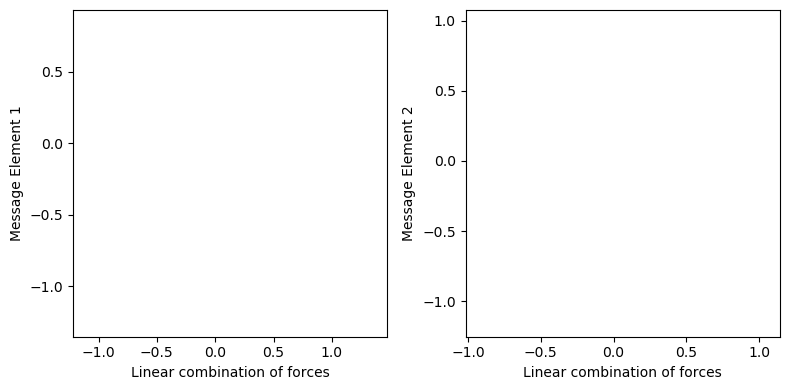

In [54]:
# Note: because we stopped recording all messages, this no longer works

# #Only turn on one of these:
# plot_force_components = True
# plot_sparsity = False
# plot_rotation = False
# if plot_force_components:
#     fig, ax = plt.subplots(1, dim, figsize=(4*dim, 4))
# if plot_sparsity or plot_rotation:
#     fig, ax = plt.subplots(1, 1)
# cam = Camera(fig)


# last_alpha_x1 = 0.0
# last_alpha_y1 = 0.0
# t = lambda _: _#tqdm
# for i in t(range(0, len(messages_over_time), 1)):
#     msgs = copy(messages_over_time[i])

#     msgs['bd'] = msgs.r + 1e-2

#     try:
#         msg_columns = ['e%d'%(k) for k in range(1, msg_dim+1)]
#         msg_array = np.array(msgs[msg_columns])
#     except:
#         msg_columns = ['e%d'%(k) for k in range(msg_dim)]
#         msg_array = np.array(msgs[msg_columns])

#     msg_importance = msg_array.std(axis=0)
#     most_important = np.argsort(msg_importance)[-dim:]
#     msgs_to_compare = msg_array[:, most_important]
#     msgs_to_compare = (msgs_to_compare - np.average(msgs_to_compare, axis=0)) / np.std(msgs_to_compare, axis=0)

#     if plot_sparsity:
#         ax.pcolormesh(msg_importance[np.argsort(msg_importance)[::-1][None, :15]], cmap='gray_r', edgecolors='k')
#         # plt.colorbar()
#         plt.axis('off')
#         plt.grid(True)
#         ax.set_aspect('equal')
#         plt.text(15.5, 0.5, '...', fontsize=30)
#         # fig.suptitle(title + test + 'mse=%.3e'%(min_result.fun/len(msgs),))
#         plt.tight_layout()
    
#     if plot_force_components or plot_rotation:
#         pos_cols = ['dx', 'dy']
#         if dim == 3:
#             pos_cols.append('dz')

#         if sim != 'spring':
#             raise NotImplementedError("The current force function is for a spring. You will need to change the force function below to that expected by your simulation.")
#         force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]

#         expected_forces = force_fnc(msgs)

#         def percentile_sum(x):
#             x = x.ravel()
#             bot = x.min()
#             top = np.percentile(x, 90)
#             msk = (x>=bot) & (x<=top)
#             frac_good = (msk).sum()/len(x)
#             return x[msk].sum()/frac_good

#         from scipy.optimize import minimize

#         def linear_transformation_2d(alpha):

#             lincomb1 = (alpha[0] * expected_forces[:, 0] + alpha[1] * expected_forces[:, 1]) + alpha[2]
#             lincomb2 = (alpha[3] * expected_forces[:, 0] + alpha[4] * expected_forces[:, 1]) + alpha[5]

#             score = (
#                 percentile_sum(np.square(msgs_to_compare[:, 0] - lincomb1)) +
#                 percentile_sum(np.square(msgs_to_compare[:, 1] - lincomb2))
#             )/2.0

#             return score

#         def out_linear_transformation_2d(alpha):
#             lincomb1 = (alpha[0] * expected_forces[:, 0] + alpha[1] * expected_forces[:, 1]) + alpha[2]
#             lincomb2 = (alpha[3] * expected_forces[:, 0] + alpha[4] * expected_forces[:, 1]) + alpha[5]

#             return lincomb1, lincomb2

#         def linear_transformation_3d(alpha):

#             lincomb1 = (alpha[0] * expected_forces[:, 0] + alpha[1] * expected_forces[:, 1] + alpha[2] * expected_forces[:, 2]) + alpha[3]
#             lincomb2 = (alpha[0+4] * expected_forces[:, 0] + alpha[1+4] * expected_forces[:, 1] + alpha[2+4] * expected_forces[:, 2]) + alpha[3+4]
#             lincomb3 = (alpha[0+8] * expected_forces[:, 0] + alpha[1+8] * expected_forces[:, 1] + alpha[2+8] * expected_forces[:, 2]) + alpha[3+8]

#             score = (
#                 percentile_sum(np.square(msgs_to_compare[:, 0] - lincomb1)) +
#                 percentile_sum(np.square(msgs_to_compare[:, 1] - lincomb2)) +
#                 percentile_sum(np.square(msgs_to_compare[:, 2] - lincomb3))
#             )/3.0

#             return score

#         def out_linear_transformation_3d(alpha):

#             lincomb1 = (alpha[0] * expected_forces[:, 0] + alpha[1] * expected_forces[:, 1] + alpha[2] * expected_forces[:, 2]) + alpha[3]
#             lincomb2 = (alpha[0+4] * expected_forces[:, 0] + alpha[1+4] * expected_forces[:, 1] + alpha[2+4] * expected_forces[:, 2]) + alpha[3+4]
#             lincomb3 = (alpha[0+8] * expected_forces[:, 0] + alpha[1+8] * expected_forces[:, 1] + alpha[2+8] * expected_forces[:, 2]) + alpha[3+8]

#             return lincomb1, lincomb2, lincomb3

#         if dim == 2:
#             min_result = minimize(linear_transformation_2d, np.ones(dim**2 + dim), method='Powell')
#         if dim == 3:
#             min_result = minimize(linear_transformation_3d, np.ones(dim**2 + dim), method='Powell')
#         print(title, test, 'gets', min_result.fun/len(msgs))

#         if plot_rotation:
#             q = min_result.x
#             alphax1, alphay1, offset1 = q[:3]
#             alphax2, alphay2, offset2 = q[3:]
            
#             s1 = alphax1**2 + alphay1**2
#             s2 = alphax2**2 + alphay2**2
            
#             if (
#                     (alphax2 - last_alpha_x1)**2
#                     + (alphay2 - last_alpha_y1)**2  <
#                    (alphax1 - last_alpha_x1)**2
#                     + (alphay1 - last_alpha_y1)**2):
                
#                 alphax1, alphay1, offset1 = q[3:]
#                 alphax2, alphay2, offset2 = q[:3]
                
#             last_alpha_x1 = alphax1
#             last_alpha_y1 = alphay1
#             s1 = alphax1**2 + alphay1**2
#             s2 = alphax2**2 + alphay2**2
#             alphax1 /= s1**0.5 * 2
#             alphay1 /= s1**0.5 * 2
#             alphax2 /= s2**0.5 * 2
#             alphay2 /= s2**0.5 * 2
            
#             ax.arrow(0.5, 0.5, alphax1, alphay1, color='k', head_width=0.05, length_includes_head=True)
#             ax.arrow(0.5, 0.5, alphax2, alphay2, color='k', head_width=0.05, length_includes_head=True)
#             ax.axis('off')
        
#         if plot_force_components:
#             for i in range(dim):
#                 if dim == 3:
#                     px = out_linear_transformation_3d(min_result.x)[i]
#                 else:
#                     px = out_linear_transformation_2d(min_result.x)[i]

#                 py = msgs_to_compare[:, i]
#                 ax[i].scatter(px, py,
#                               alpha=0.1, s=0.1, color='k')
#                 ax[i].set_xlabel('Linear combination of forces')
#                 ax[i].set_ylabel('Message Element %d'%(i+1))

#                 xlim = np.array([np.percentile(px, q) for q in [10, 90]])
#                 ylim = np.array([np.percentile(py, q) for q in [10, 90]])
#                 xlim[0], xlim[1] = xlim[0] - (xlim[1] - xlim[0])*0.05, xlim[1] + (xlim[1] - xlim[0])*0.05
#                 ylim[0], ylim[1] = ylim[0] - (ylim[1] - ylim[0])*0.05, ylim[1] + (ylim[1] - ylim[0])*0.05

#                 ax[i].set_xlim(xlim)
#                 ax[i].set_ylim(ylim)
                
#         plt.tight_layout()
    
#     cam.snap()

# ani = cam.animate()
    
# from IPython.display import HTML
# HTML(ani.to_jshtml())

## Plot some predicted versus true trajectories:

In [55]:
from simulate import make_transparent_color

In [56]:
from scipy.integrate import odeint

In [57]:
# fig, ax = plt.subplots(1, 2, figsize=(8, 4))
# camera = Camera(fig)

# for current_model in [-1] + [1, 34, 67, 100, 133, 166, 199]:
#     i = 4 #Use this simulation
#     if current_model > len(recorded_models):
#         continue

#     #Truth:
#     cutoff_time = 300
#     times = onp.array(s.times)[:cutoff_time]
#     x_times = onp.array(data[i, :cutoff_time])
#     masses = x_times[:, :, -1]
#     length_of_tail = 75

#     #Learned:
#     e = edge_index.cuda()
#     ogn.cpu()
#     if current_model > -1:
#         ogn.load_state_dict(recorded_models[current_model])
#     else:
#         # Random model!
#         ogn = OGN(n_f, msg_dim, dim, dt=0.1, hidden=hidden, edge_index=get_edge_index(n, sim), aggr=aggr).cuda()
#     ogn.cuda()
    
#     def odefunc(y, t=None):
#         y = y.reshape(4, 6).astype(np.float32)
#         cur = Data(
#             x=torch.from_numpy(y).cuda(),
#             edge_index=e
#         )
#         dx = y[:, 2:4]
#         dv = ogn.just_derivative(cur).cpu().detach().numpy()
#         dother = np.zeros_like(dx)
#         return np.concatenate((dx, dv, dother), axis=1).ravel()

#     datai = odeint(odefunc, (onp.asarray(x_times[0]).ravel()), times).reshape(-1, 4, 6)
#     x_times2 = onp.array(datai)

#     d_idx = 10
#     for t_idx in range(d_idx, cutoff_time, d_idx):
#         start = max([0, t_idx-length_of_tail])
#         ctimes = times[start:t_idx]
#         cx_times = x_times[start:t_idx]
#         cx_times2 = x_times2[start:t_idx]
#         for j in range(n):
#             rgba = make_transparent_color(len(ctimes), j/n)
#             ax[0].scatter(cx_times[:, j, 0], cx_times[:, j, 1], color=rgba)
#             ax[1].scatter(cx_times2[:, j, 0], cx_times2[:, j, 1], color=rgba)
#             black_rgba = rgba
#             black_rgba[:, :3] = 0.75
#             ax[1].scatter(cx_times[:, j, 0], cx_times[:, j, 1], color=black_rgba, zorder=-1)

#         for k in range(2):
#             ax[k].set_xlim(-1, 3)
#             ax[k].set_ylim(-3, 1)
#         plt.tight_layout()
#         camera.snap()

# # camera.animate().save('multiple_animations_with_comparison.mp4')
# from IPython.display import HTML
# HTML(camera.animate().to_jshtml())

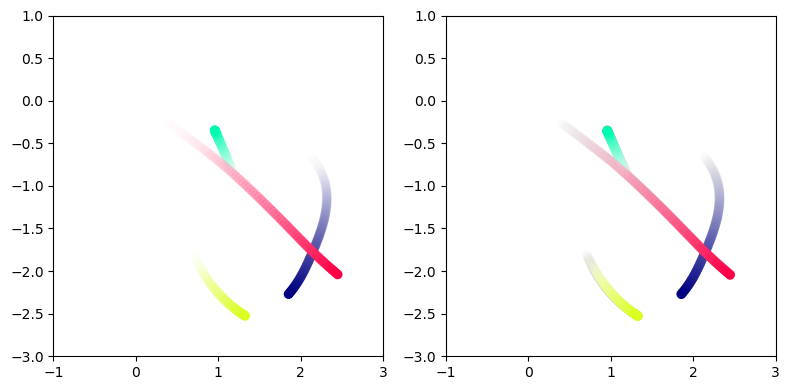

In [58]:
# Note: because we stopped recording all models, this no longer works

# # no cuda
# fig, ax = plt.subplots(1, 2, figsize=(8, 4))
# camera = Camera(fig)

# for current_model in [-1] + [1, 34, 67, 100, 133, 166, 199]:
#     i = 4 #Use this simulation
#     if current_model > len(recorded_models):
#         continue

#     #Truth:
#     cutoff_time = 300
#     times = onp.array(s.times)[:cutoff_time]
#     x_times = onp.array(data[i, :cutoff_time])
#     masses = x_times[:, :, -1]
#     length_of_tail = 75

#     #Learned:
#     e = edge_index
#     ogn.cpu()
#     if current_model > -1:
#         ogn.load_state_dict(recorded_models[current_model])
#     else:
#         # Random model!
#         ogn = OGN(n_f, msg_dim, dim, dt=0.1, hidden=hidden, edge_index=get_edge_index(n, sim), aggr=aggr)
    
#     def odefunc(y, t=None):
#         y = y.reshape(4, 6).astype(np.float32)
#         cur = Data(
#             x=torch.from_numpy(y),
#             edge_index=e
#         )
#         dx = y[:, 2:4]
#         dv = ogn.just_derivative(cur).cpu().detach().numpy()
#         dother = np.zeros_like(dx)
#         return np.concatenate((dx, dv, dother), axis=1).ravel()

#     datai = odeint(odefunc, (onp.asarray(x_times[0]).ravel()), times).reshape(-1, 4, 6)
#     x_times2 = onp.array(datai)

#     d_idx = 10
#     for t_idx in range(d_idx, cutoff_time, d_idx):
#         start = max([0, t_idx-length_of_tail])
#         ctimes = times[start:t_idx]
#         cx_times = x_times[start:t_idx]
#         cx_times2 = x_times2[start:t_idx]
#         for j in range(n):
#             rgba = make_transparent_color(len(ctimes), j/n)
#             ax[0].scatter(cx_times[:, j, 0], cx_times[:, j, 1], color=rgba)
#             ax[1].scatter(cx_times2[:, j, 0], cx_times2[:, j, 1], color=rgba)
#             black_rgba = rgba
#             black_rgba[:, :3] = 0.75
#             ax[1].scatter(cx_times[:, j, 0], cx_times[:, j, 1], color=black_rgba, zorder=-1)

#         for k in range(2):
#             ax[k].set_xlim(-1, 3)
#             ax[k].set_ylim(-3, 1)
#         plt.tight_layout()
#         camera.snap()

# # camera.animate().save('multiple_animations_with_comparison.mp4')
# from IPython.display import HTML
# HTML(camera.animate().to_jshtml())

# Symbolic regression

Extract the force laws with the following procedure:
- The data in `messages_over_time` correspond to inputs to, and features of, $\phi^e$, recorded during each training epoch.
- Select the last element of this list.
- Find the most significant message feature. Each message feature corresponds to 'e1', 'e2', etc. Calculate the one with the largest standard deviation.

Train [PySR](https://github.com/MilesCranmer/PySR) to fit this relationship.
Thus, we have extracted a force law from the graph network without priors on the functional form.

This is the same technique we used to extract the unknown dark matter overdensity equation from the Quijote simulations.


## Here's the best message, which we will study:

In [55]:
best_message = np.argmax([np.std(final_messages['e%d'%(i,)]) for i in range(100)])
print(best_message)

61


In [57]:
print(final_messages.columns[:13])
print(final_messages.columns[-4:])

Index(['x1', 'y1', 'vx1', 'vy1', 'q1', 'm1', 'x2', 'y2', 'vx2', 'vy2', 'q2',
       'm2', 'e0'],
      dtype='object')
Index(['e99', 'dx', 'dy', 'r'], dtype='object')


In [58]:
[(i, np.ptp(final_messages['e%d'%(i,)])) for i in range(100)]

[(0, 0.0008554475),
 (1, 0.001191054),
 (2, 0.00063924125),
 (3, 0.0012860157),
 (4, 0.0021649692),
 (5, 0.00081957574),
 (6, 0.003244646),
 (7, 0.0002729835),
 (8, 0.0005843055),
 (9, 1.4101624),
 (10, 0.0011759098),
 (11, 0.0012668383),
 (12, 0.0019458727),
 (13, 0.00050393376),
 (14, 0.00032859866),
 (15, 0.00031590118),
 (16, 0.00040452383),
 (17, 0.0005657859),
 (18, 0.0005605512),
 (19, 0.0010860799),
 (20, 0.0028879743),
 (21, 0.00066726597),
 (22, 0.0022708056),
 (23, 0.0009851534),
 (24, 0.00050725596),
 (25, 0.0008600247),
 (26, 0.0007867092),
 (27, 0.00086947624),
 (28, 0.0014990282),
 (29, 0.001914987),
 (30, 0.0017579223),
 (31, 0.008975903),
 (32, 0.08811028),
 (33, 0.00060161814),
 (34, 0.00075216044),
 (35, 0.0007071626),
 (36, 0.0023449957),
 (37, 0.0006246859),
 (38, 0.0015652054),
 (39, 0.0011973118),
 (40, 0.0006995947),
 (41, 0.0029922037),
 (42, 0.0019067576),
 (43, 0.0005903849),
 (44, 0.00032077127),
 (45, 0.0017715958),
 (46, 0.0010491835),
 (47, 0.0013093555),

## Here's a pandas dataframe of the message data:

In [59]:
final_messages[['e%d'%(best_message,), 'dx', 'dy', 'r', 'm1', 'm2']]

,e61,dx,dy,r,m1,m2
0,-0.006447,0.543490,-0.778915,0.949784,5.785905,0.836671
1,-0.864056,1.947126,1.091564,2.232221,5.785905,0.770745
2,0.007447,0.818098,-0.411029,0.915549,5.785905,0.800204
3,0.007708,-0.543490,0.778915,0.949784,0.836671,5.785905
4,-1.043603,1.403636,1.870479,2.338565,0.836671,0.770745
...,...,...,...,...,...,...
11995,0.137307,0.491155,-0.143345,0.511645,0.163864,0.695851
11996,0.039369,0.882834,-0.116667,0.890510,0.163864,1.765544
11997,-0.533353,0.827246,1.477601,1.693411,1.765544,0.581951
11998,-0.314498,-0.391680,-0.026678,0.392587,1.765544,0.695851


## Now we just fit eMAX as a function of dx, dy, r, m1, and m2, inside [PySR](https://github.com/MilesCranmer/PySR).